# **Component Extraction from the following images**

## **circle**

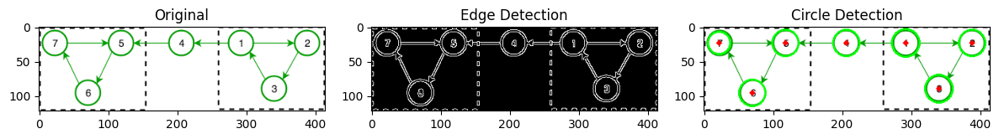

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def extract_circles(image_path):
    # Load image
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply edge detection
    edges = cv2.Canny(blurred, 50, 150)

    # Detect circles using Hough Transform
    circles = cv2.HoughCircles(
        blurred, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
        param1=50, param2=30, minRadius=10, maxRadius=50
    )

    # Draw detected circles
    result = img.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for i in circles[0, :]:
            # Draw outer circle
            cv2.circle(result, (i[0], i[1]), i[2], (0, 255, 0), 2)
            # Draw center
            cv2.circle(result, (i[0], i[1]), 2, (0, 0, 255), 3)

    # Display results
    plt.figure(figsize=(12, 6))
    plt.subplot(131), plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(132), plt.imshow(edges, cmap='gray'), plt.title('Edge Detection')
    plt.subplot(133), plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB)), plt.title('Circle Detection')
    plt.tight_layout()
    plt.show()

    return img, result



# Usage
original, processed = extract_circles('/content/7 circles.png')

## **covid**

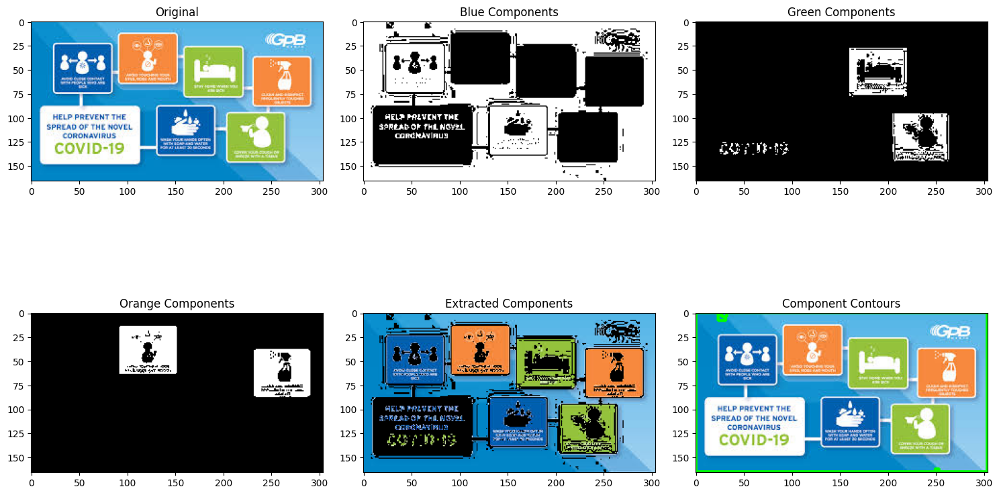

In [5]:

# **COVID Component Extraction**
def extract_covid_components(image_path):
    # Load image
    img = cv2.imread(image_path)

    # Convert to HSV for better color segmentation
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Define color ranges for different components (adjust as needed)
    lower_blue = np.array([100, 50, 50])
    upper_blue = np.array([140, 255, 255])
    blue_mask = cv2.inRange(hsv, lower_blue, upper_blue)

    lower_green = np.array([40, 50, 50])
    upper_green = np.array([80, 255, 255])
    green_mask = cv2.inRange(hsv, lower_green, upper_green)

    lower_orange = np.array([10, 100, 100])
    upper_orange = np.array([25, 255, 255])
    orange_mask = cv2.inRange(hsv, lower_orange, upper_orange)

    combined_mask = blue_mask + green_mask + orange_mask
    result = cv2.bitwise_and(img, img, mask=combined_mask)

    # Find contours for component extraction
    contours, _ = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Draw contours on a copy of the original image
    contour_img = img.copy()
    cv2.drawContours(contour_img, contours, -1, (0, 255, 0), 2)

    # K-means clustering for better component segmentation
    def kmeans_clustering(img, n_clusters=3):
        img_reshaped = img.reshape((-1, 3))
        kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(img_reshaped)
        clustered_img = kmeans.cluster_centers_[kmeans.labels_].reshape(img.shape)
        return clustered_img.astype(np.uint8)

    clustered_img = kmeans_clustering(img)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(232), plt.imshow(blue_mask, cmap='gray'), plt.title('Blue Components')
    plt.subplot(233), plt.imshow(green_mask, cmap='gray'), plt.title('Green Components')
    plt.subplot(234), plt.imshow(orange_mask, cmap='gray'), plt.title('Orange Components')
    plt.subplot(235), plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB)), plt.title('Extracted Components')
    plt.subplot(236), plt.imshow(cv2.cvtColor(contour_img, cv2.COLOR_BGR2RGB)), plt.title('Component Contours')
    plt.tight_layout()
    plt.show()

    return img, result, contour_img

# Usage
original, extracted, contours = extract_covid_components('/content/Multi_objects_separation.jpeg')

# **Enhancement of Blurry Images**

## **Building**

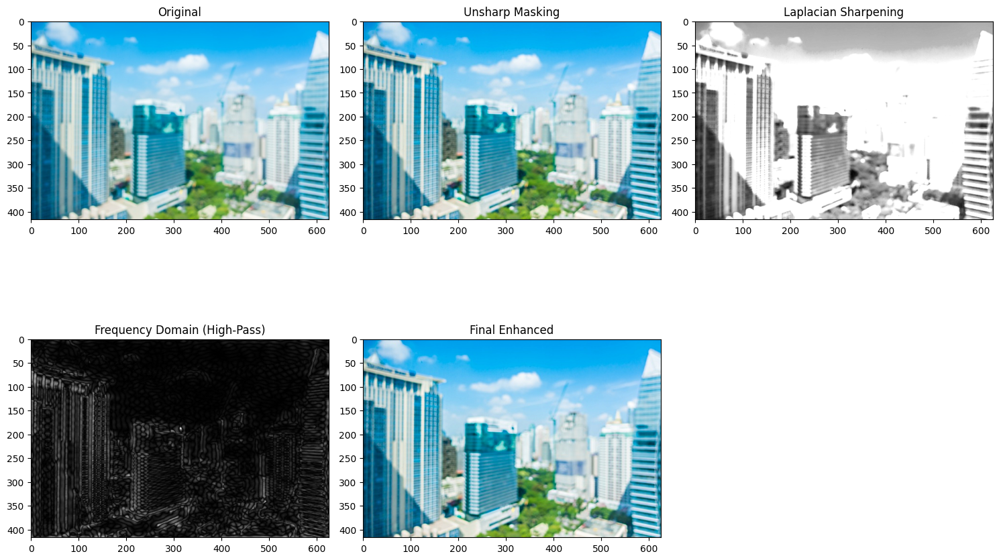

In [6]:

## **Building Enhancement**
def enhance_blurry_buildings(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Unsharp masking
    gaussian = cv2.GaussianBlur(img, (0, 0), 3)
    unsharp_masked = cv2.addWeighted(img, 1.5, gaussian, -0.5, 0)

    # Method 2: Laplacian sharpening
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    laplacian = np.uint8(np.absolute(laplacian))
    laplacian_sharpened = cv2.addWeighted(gray, 1.5, laplacian, -0.5, 0)

    # Method 3: Frequency domain filtering (high-pass filter)
    dft = cv2.dft(np.float32(gray), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    rows, cols = gray.shape
    crow, ccol = rows // 2, cols // 2
    mask = np.ones((rows, cols, 2), np.uint8)
    r = 30
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= r*r
    mask[mask_area] = 0

    fshift = dft_shift * mask
    f_ishift = np.fft.ifftshift(fshift)
    img_back = cv2.idft(f_ishift)
    img_back = cv2.magnitude(img_back[:,:,0], img_back[:,:,1])

    # Normalize for display
    img_back = cv2.normalize(img_back, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(232), plt.imshow(cv2.cvtColor(unsharp_masked, cv2.COLOR_BGR2RGB)), plt.title('Unsharp Masking')
    plt.subplot(233), plt.imshow(laplacian_sharpened, cmap='gray'), plt.title('Laplacian Sharpening')
    plt.subplot(234), plt.imshow(img_back, cmap='gray'), plt.title('Frequency Domain (High-Pass)')
    plt.subplot(235), plt.imshow(cv2.cvtColor(unsharp_masked, cv2.COLOR_BGR2RGB)), plt.title('Final Enhanced')
    plt.tight_layout()
    plt.show()

    return img, unsharp_masked


# Usage
original, enhanced = enhance_blurry_buildings('/content/Building.jpg')

## **Dog**

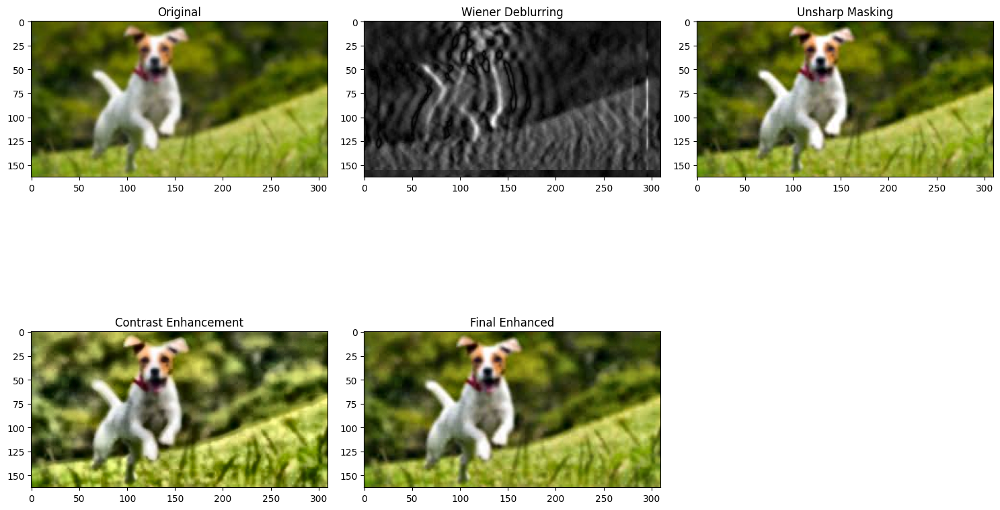

In [8]:
def enhance_blurry_dog(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Motion deblurring using Wiener filter
    size = 15
    kernel_motion_blur = np.zeros((size, size))
    kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
    kernel_motion_blur = kernel_motion_blur / size

    gray_fft = np.fft.fft2(gray)
    kernel_fft = np.fft.fft2(kernel_motion_blur, s=gray.shape)
    kernel_fft[kernel_fft == 0] = 1  # Avoid division by zero

    K = 0.01
    wiener_filter = np.conj(kernel_fft) / (np.abs(kernel_fft)**2 + K)
    deblurred_fft = gray_fft * wiener_filter
    deblurred = np.abs(np.fft.ifft2(deblurred_fft))
    deblurred = np.uint8(cv2.normalize(deblurred, None, 0, 255, cv2.NORM_MINMAX))

    # Method 2: Unsharp masking for sharpening
    gaussian = cv2.GaussianBlur(img, (0, 0), 3)
    unsharp_masked = cv2.addWeighted(img, 1.5, gaussian, -0.5, 0)

    # Method 3: Contrast enhancement
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    merged = cv2.merge((cl, a, b))
    contrast_enhanced = cv2.cvtColor(merged, cv2.COLOR_LAB2BGR)

    # Final enhanced image (combining methods)
    final_enhanced = cv2.addWeighted(unsharp_masked, 0.7, contrast_enhanced, 0.3, 0)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(232), plt.imshow(deblurred, cmap='gray'), plt.title('Wiener Deblurring')
    plt.subplot(233), plt.imshow(cv2.cvtColor(unsharp_masked, cv2.COLOR_BGR2RGB)), plt.title('Unsharp Masking')
    plt.subplot(234), plt.imshow(cv2.cvtColor(contrast_enhanced, cv2.COLOR_BGR2RGB)), plt.title('Contrast Enhancement')
    plt.subplot(235), plt.imshow(cv2.cvtColor(final_enhanced, cv2.COLOR_BGR2RGB)), plt.title('Final Enhanced')
    plt.tight_layout()
    plt.show()

    return img, final_enhanced

# Usage
original, enhanced = enhance_blurry_dog('/content/Dog.jpeg')

# **Noise removal from Noisy Images**

## **Wind image**

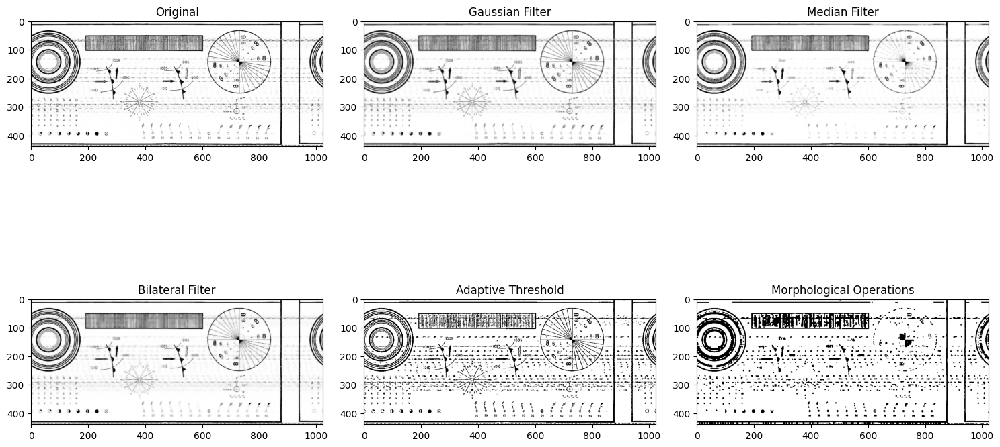

In [9]:
## **Wind Image**
def enhance_wind_chart(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Gaussian filtering
    gaussian_filtered = cv2.GaussianBlur(gray, (5, 5), 0)

    # Method 2: Median filtering (good for salt and pepper noise)
    median_filtered = cv2.medianBlur(gray, 5)

    # Method 3: Bilateral filtering (preserves edges)
    bilateral_filtered = cv2.bilateralFilter(gray, 9, 75, 75)

    # Method 4: Adaptive thresholding for better visualization
    adaptive_thresh = cv2.adaptiveThreshold(
        bilateral_filtered, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Method 5: Morphological operations to clean up
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=1)

    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(gray, cmap='gray'), plt.title('Original')
    plt.subplot(232), plt.imshow(gaussian_filtered, cmap='gray'), plt.title('Gaussian Filter')
    plt.subplot(233), plt.imshow(median_filtered, cmap='gray'), plt.title('Median Filter')
    plt.subplot(234), plt.imshow(bilateral_filtered, cmap='gray'), plt.title('Bilateral Filter')
    plt.subplot(235), plt.imshow(adaptive_thresh, cmap='gray'), plt.title('Adaptive Threshold')
    plt.subplot(236), plt.imshow(closing, cmap='gray'), plt.title('Morphological Operations')
    plt.tight_layout()
    plt.show()

    return img, closing


# Usage
original, enhanced = enhance_wind_chart('/content/Noisy_1.png')

## **rocket**

In [10]:
!pip install PyWavelets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 39.7 MB/s eta 0:00:00


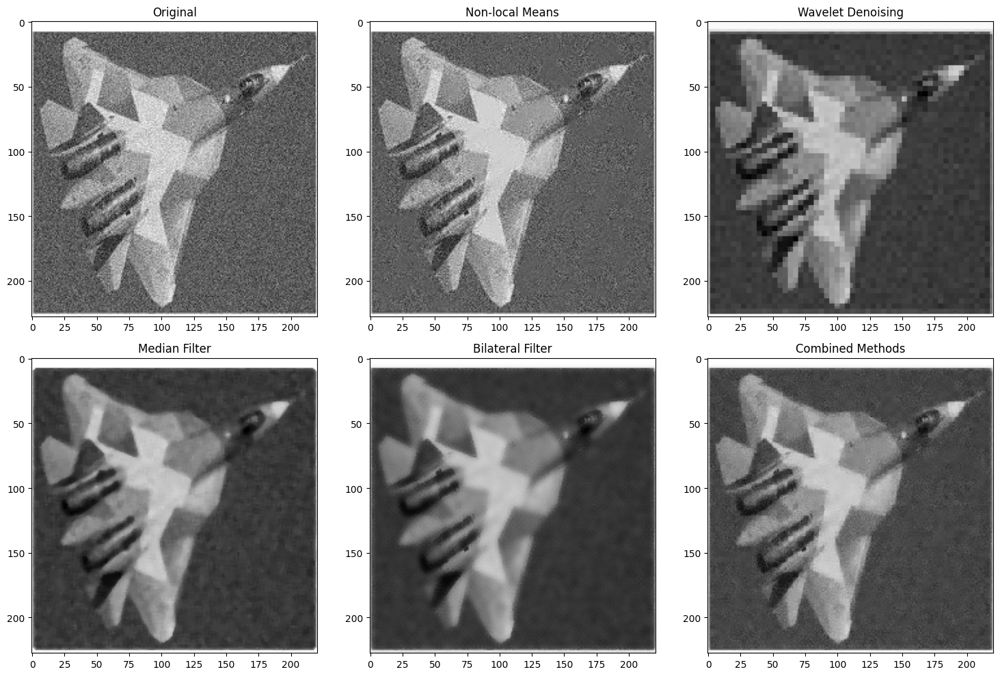

In [12]:
## **Rocket Image**
import pywt

def denoise_rocket_image(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Non-local means denoising
    dst = cv2.fastNlMeansDenoising(gray, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Wavelet denoising
    coeffs = pywt.wavedec2(gray, 'bior1.3', level=2)
    sigma = np.median(np.abs(coeffs[-1][0])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(gray.size))
    coeffs_thresholded = [coeffs[0]]

    for i in range(1, len(coeffs)):
        detail_coeffs = [pywt.threshold(detail, threshold, mode='soft') for detail in coeffs[i]]
        coeffs_thresholded.append(tuple(detail_coeffs))

    wavelet_denoised = pywt.waverec2(coeffs_thresholded, 'bior1.3')
    wavelet_denoised = wavelet_denoised[:gray.shape[0], :gray.shape[1]]
    wavelet_denoised = np.uint8(cv2.normalize(wavelet_denoised, None, 0, 255, cv2.NORM_MINMAX))

    # Median filtering
    median_filtered = cv2.medianBlur(gray, 5)

    # Bilateral filtering
    bilateral_filtered = cv2.bilateralFilter(gray, 9, 75, 75)

    # Combine methods (weighted average)
    combined = cv2.addWeighted(dst, 0.4, wavelet_denoised, 0.3, 0)
    combined = cv2.addWeighted(combined, 0.7, bilateral_filtered, 0.3, 0)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(gray, cmap='gray'), plt.title('Original')
    plt.subplot(232), plt.imshow(dst, cmap='gray'), plt.title('Non-local Means')
    plt.subplot(233), plt.imshow(wavelet_denoised, cmap='gray'), plt.title('Wavelet Denoising')
    plt.subplot(234), plt.imshow(median_filtered, cmap='gray'), plt.title('Median Filter')
    plt.subplot(235), plt.imshow(bilateral_filtered, cmap='gray'), plt.title('Bilateral Filter')
    plt.subplot(236), plt.imshow(combined, cmap='gray'), plt.title('Combined Methods')
    plt.tight_layout()
    plt.show()

    return img, combined

# Usage
original, denoised = denoise_rocket_image('/content/Rocket.jpeg')

## **Text**

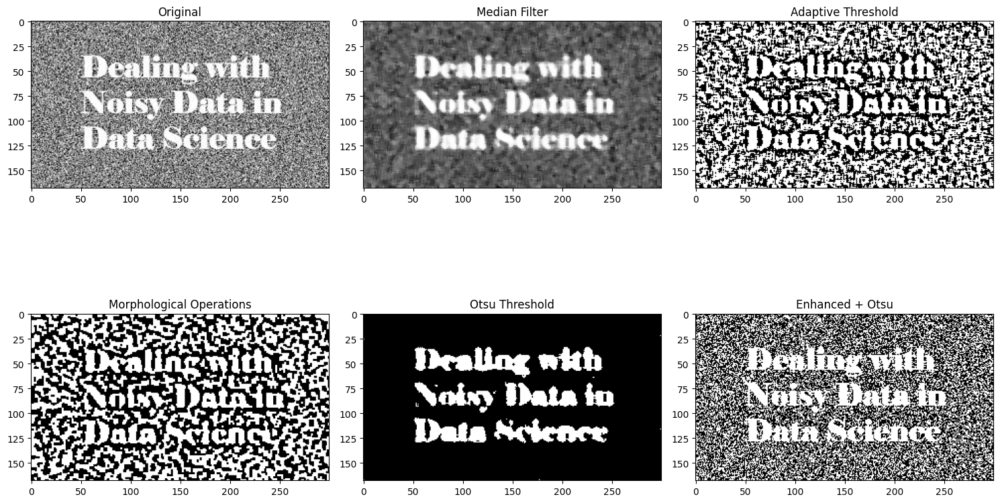

In [13]:
def enhance_noisy_text(image_path):
    # Load image
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Median filtering (good for salt and pepper noise)
    median_filtered = cv2.medianBlur(gray, 5)

    # Method 2: Adaptive thresholding
    adaptive_thresh = cv2.adaptiveThreshold(
        median_filtered, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Method 3: Morphological operations
    kernel = np.ones((2, 2), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=1)

    # Method 4: Otsu's thresholding
    _, otsu = cv2.threshold(median_filtered, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Method 5: Contrast enhancement before thresholding
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(gray)
    _, enhanced_otsu = cv2.threshold(enhanced, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(gray, cmap='gray'), plt.title('Original')
    plt.subplot(232), plt.imshow(median_filtered, cmap='gray'), plt.title('Median Filter')
    plt.subplot(233), plt.imshow(adaptive_thresh, cmap='gray'), plt.title('Adaptive Threshold')
    plt.subplot(234), plt.imshow(closing, cmap='gray'), plt.title('Morphological Operations')
    plt.subplot(235), plt.imshow(otsu, cmap='gray'), plt.title('Otsu Threshold')
    plt.subplot(236), plt.imshow(enhanced_otsu, cmap='gray'), plt.title('Enhanced + Otsu')

    plt.tight_layout()
    plt.show()

    return img, enhanced_otsu

# Usage
original, enhanced = enhance_noisy_text('/content/Text.jpeg')

# **Visual enhancement of the following images (Challenging Images)**

## **Newspaper**

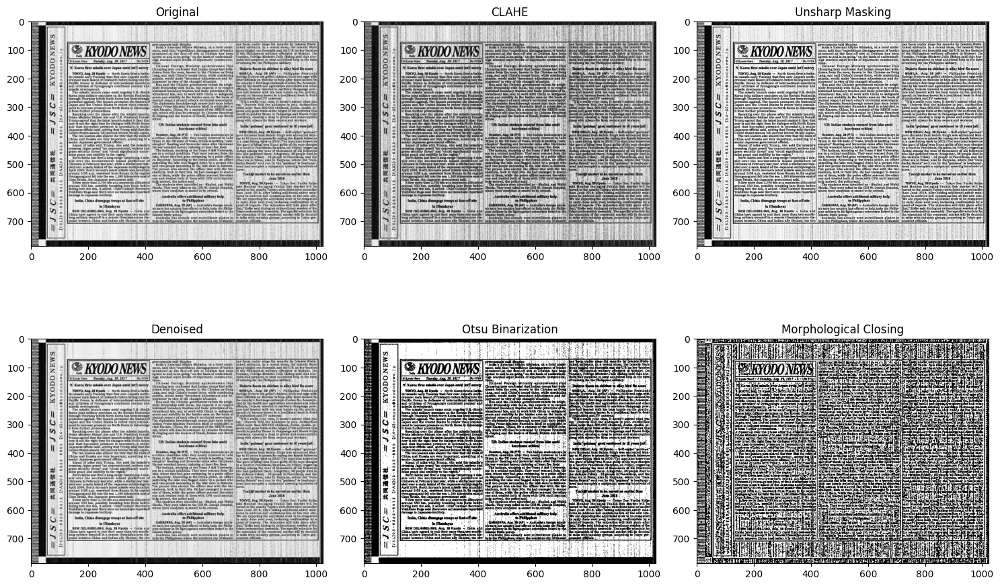

In [14]:
def enhance_newspaper(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Contrast enhancement using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_applied = clahe.apply(gray)

    # Unsharp Masking for sharpening
    gaussian = cv2.GaussianBlur(gray, (0, 0), 3)
    unsharp_masked = cv2.addWeighted(gray, 1.5, gaussian, -0.5, 0)

    # Denoising
    denoised = cv2.fastNlMeansDenoising(gray, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Binarization for text clarity
    _, binary = cv2.threshold(clahe_applied, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Adaptive thresholding
    adaptive_thresh = cv2.adaptiveThreshold(
        clahe_applied, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Morphological operations to clean up
    kernel = np.ones((2, 2), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=1)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(gray, cmap='gray'), plt.title('Original')
    plt.subplot(232), plt.imshow(clahe_applied, cmap='gray'), plt.title('CLAHE')
    plt.subplot(233), plt.imshow(unsharp_masked, cmap='gray'), plt.title('Unsharp Masking')
    plt.subplot(234), plt.imshow(denoised, cmap='gray'), plt.title('Denoised')
    plt.subplot(235), plt.imshow(binary, cmap='gray'), plt.title('Otsu Binarization')
    plt.subplot(236), plt.imshow(closing, cmap='gray'), plt.title('Morphological Closing')
    plt.tight_layout()
    plt.show()

    return img, closing

# Usage
original, enhanced = enhance_newspaper('/content/Noisy_2.jpg')

## **Nameplate**

Nameplate sharpened image saved as 'nameplate_sharpened.jpg'


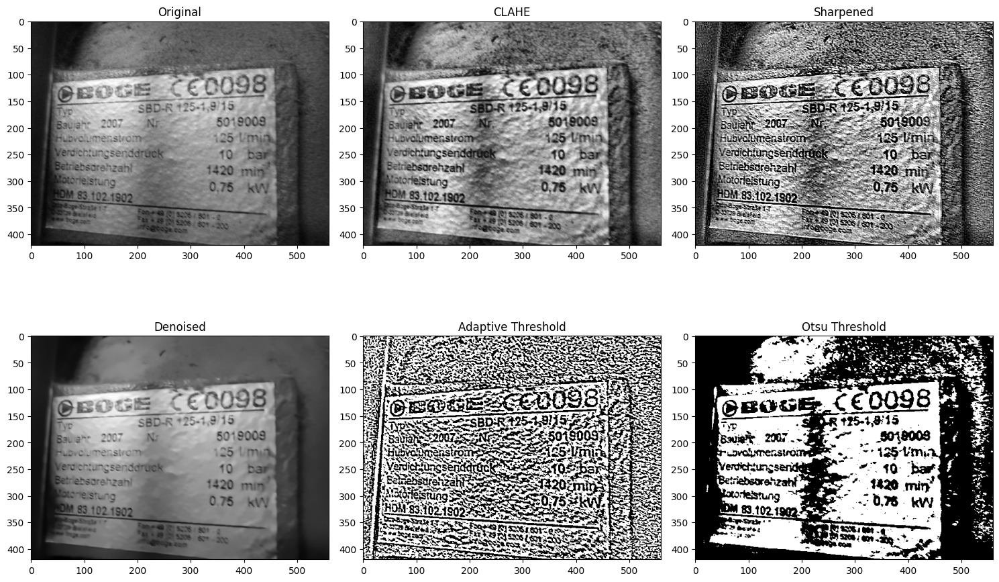

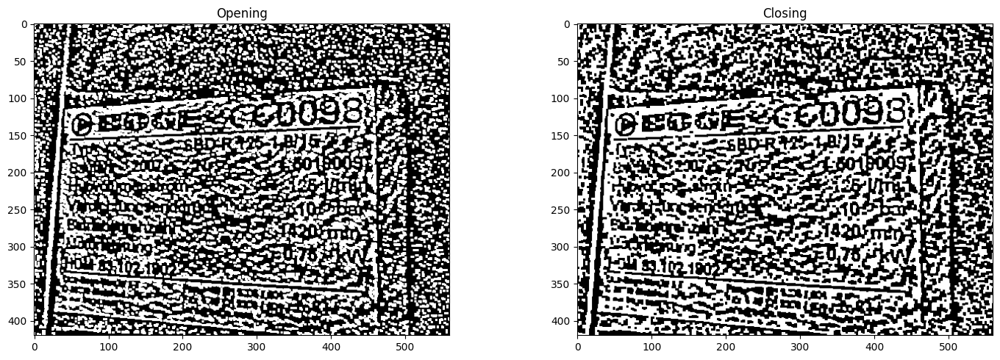

In [39]:
def enhance_nameplate(image_path):
    # Load image
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Contrast enhancement using CLAHE
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    clahe_applied = clahe.apply(gray)

    # Method 2: Sharpening with kernel
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    sharpened = cv2.filter2D(clahe_applied, -1, kernel)

    # Save the sharpened image
    cv2.imwrite('nameplate_sharpened.jpg', sharpened)
    print("Nameplate sharpened image saved as 'nameplate_sharpened.jpg'")

    # Method 3: Denoising
    denoised = cv2.fastNlMeansDenoising(gray, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Method 4: Adaptive thresholding
    adaptive_thresh = cv2.adaptiveThreshold(
        clahe_applied, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Method 5: Otsu's thresholding
    _, otsu = cv2.threshold(clahe_applied, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Method 6: Morphological operations (opening and closing)
    kernel_morph = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel_morph, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel_morph, iterations=1)

    # Display results
    plt.figure(figsize=(15, 10))
    plt.subplot(231), plt.imshow(gray, cmap='gray'), plt.title('Original')
    plt.subplot(232), plt.imshow(clahe_applied, cmap='gray'), plt.title('CLAHE')
    plt.subplot(233), plt.imshow(sharpened, cmap='gray'), plt.title('Sharpened')
    plt.subplot(234), plt.imshow(denoised, cmap='gray'), plt.title('Denoised')
    plt.subplot(235), plt.imshow(adaptive_thresh, cmap='gray'), plt.title('Adaptive Threshold')
    plt.subplot(236), plt.imshow(otsu, cmap='gray'), plt.title('Otsu Threshold')  # Display Otsu
    plt.tight_layout()
    plt.show()

    # Displaying Opening and Closing results separately
    plt.figure(figsize=(15, 5))
    plt.subplot(121), plt.imshow(opening, cmap='gray'), plt.title('Opening')
    plt.subplot(122), plt.imshow(closing, cmap='gray'), plt.title('Closing')
    plt.tight_layout()
    plt.show()

    # Return the original and sharpened image instead of closing
    return img, sharpened

# Usage
original, enhanced = enhance_nameplate('/content/Name plate.jpg')

# **All images**

In [21]:
import os

Processing Circle Image...


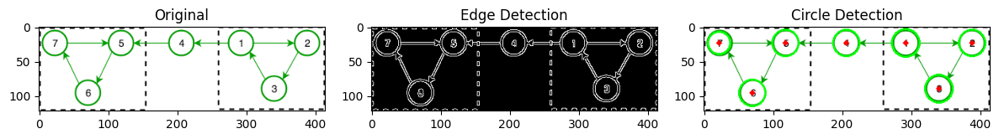

Processing COVID-19 Chart...


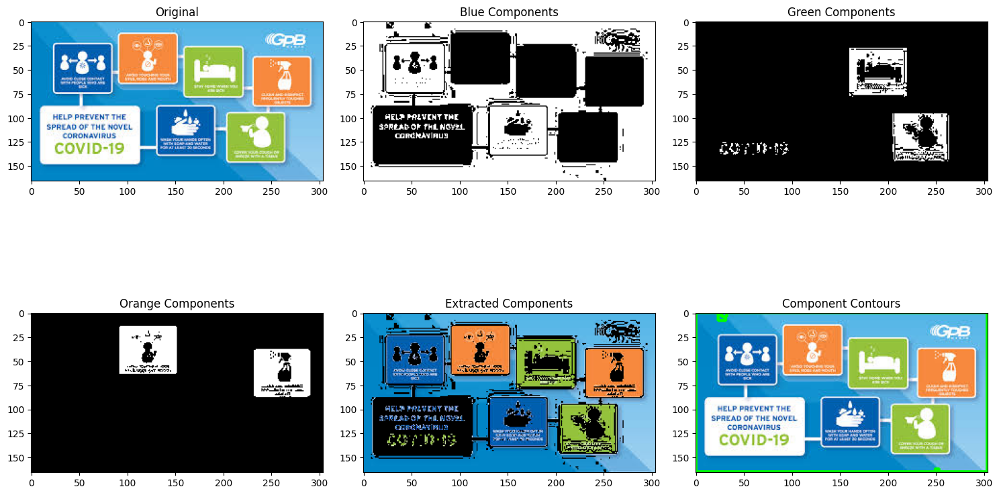

Processing Blurry Buildings Image...


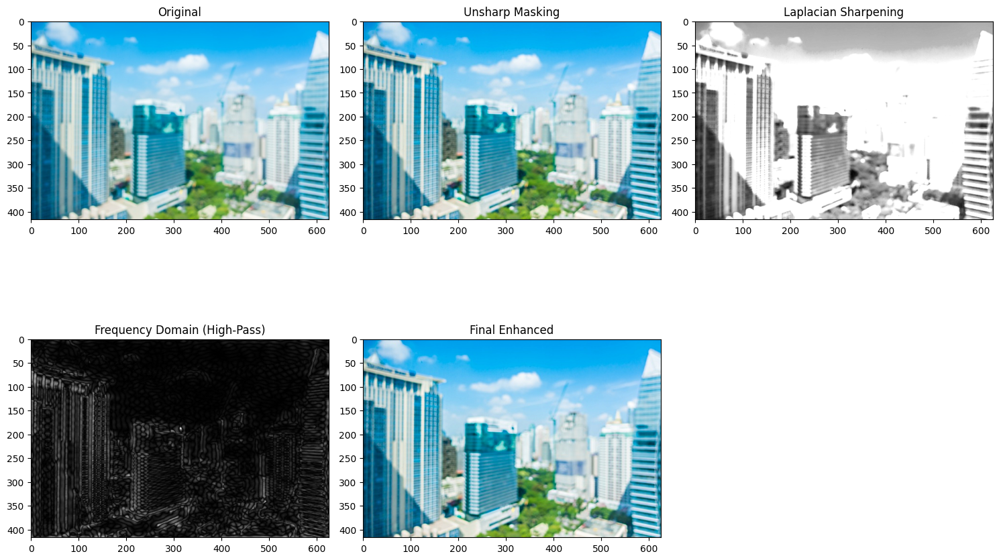

Processing Blurry Dog Image...


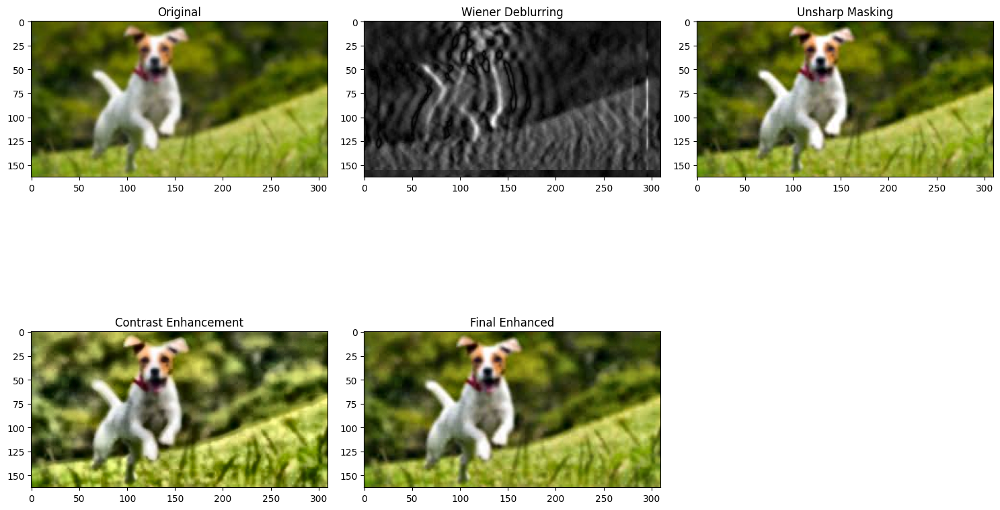

Processing Wind Chart Image...


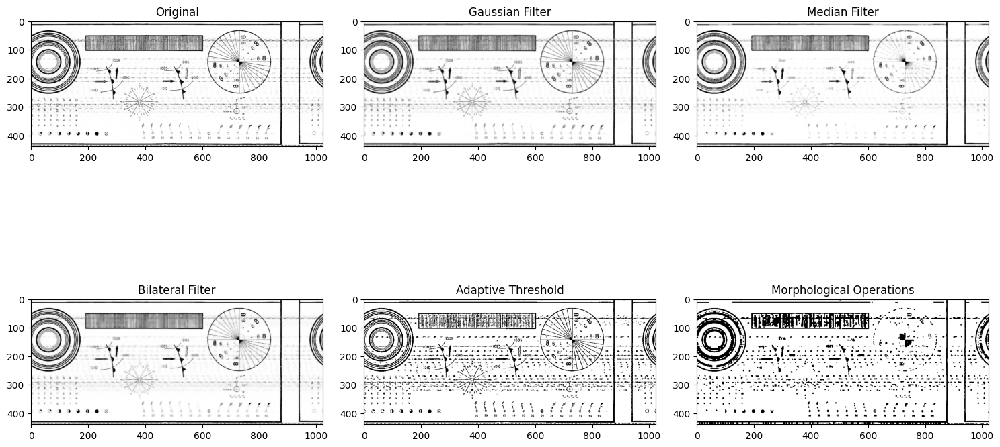

Processing Rocket Image...


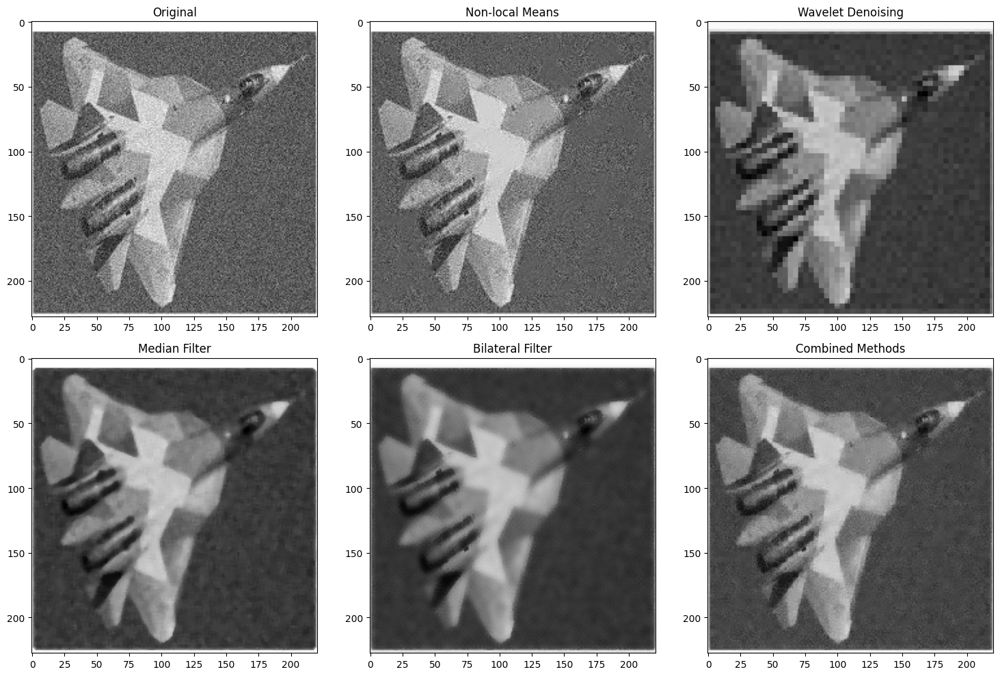

Processing Noisy Text Image...


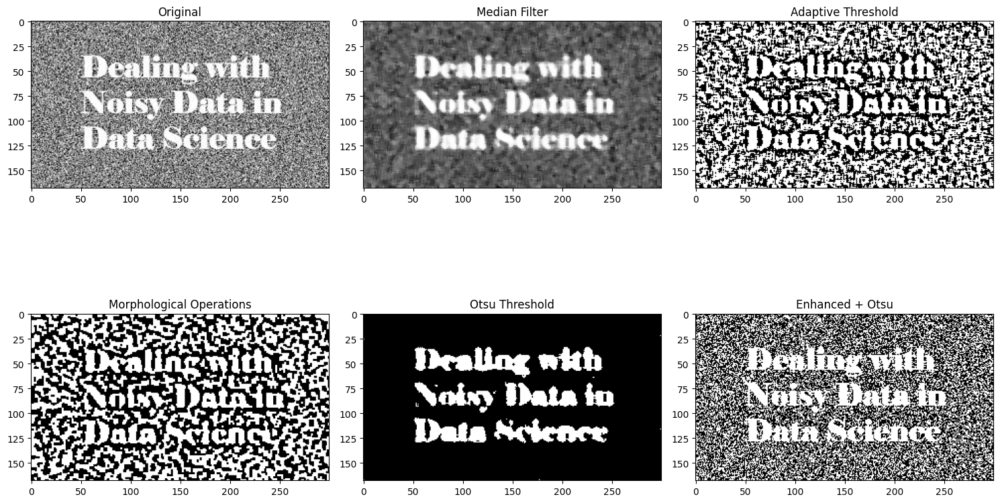

Processing Newspaper Image...


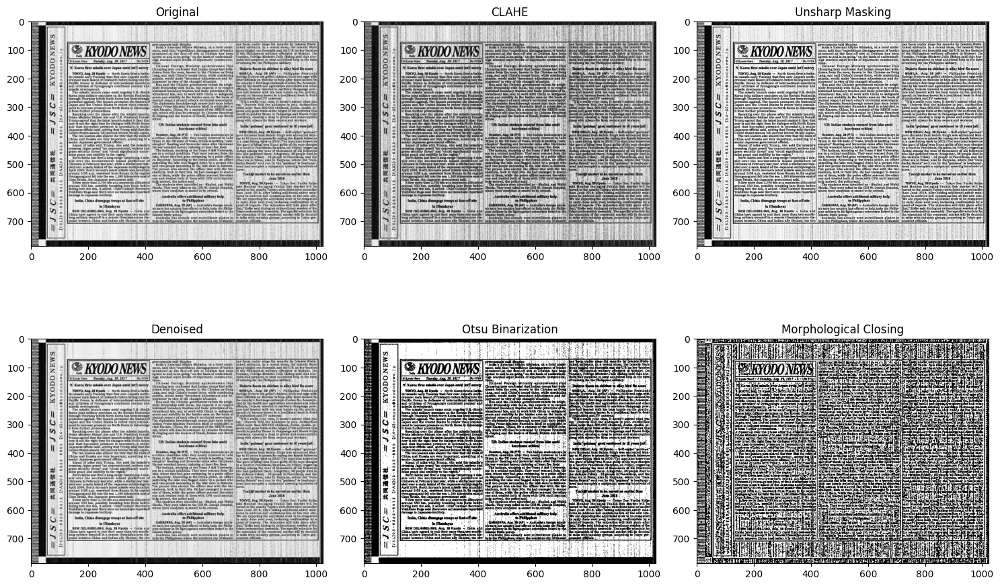

Processing Name Plate Image...


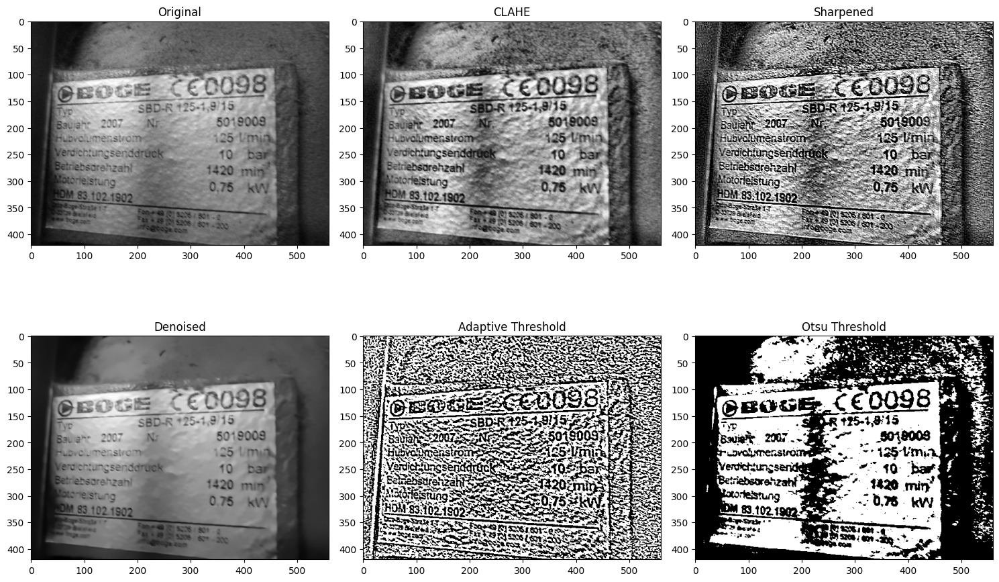

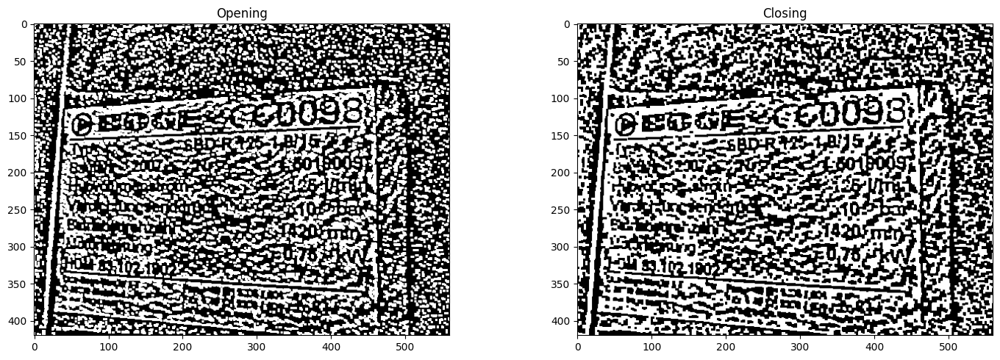

All images processed and saved successfully!


In [22]:
# For displaying images in Colab

def process_all_images(image_paths):
    # Check if all image files exist
    for key, path in image_paths.items():
        if not os.path.exists(path):
            print(f"Warning: Image file for '{key}' does not exist at path: {path}")

    # 1. Component Extraction
    print("Processing Circle Image...")
    circle_original, circle_processed = extract_circles(image_paths['circle'])

    print("Processing COVID-19 Chart...")
    covid_original, covid_extracted, covid_contours = extract_covid_components(image_paths['covid'])

    # 2. Enhancement of Blurry Images
    print("Processing Blurry Buildings Image...")
    buildings_original, buildings_enhanced = enhance_blurry_buildings(image_paths['buildings'])

    print("Processing Blurry Dog Image...")
    dog_original, dog_enhanced = enhance_blurry_dog(image_paths['dog'])

    # 3. Noise Removal
    print("Processing Wind Chart Image...")
    wind_original, wind_enhanced = enhance_wind_chart(image_paths['wind_chart'])

    print("Processing Rocket Image...")
    rocket_original, rocket_denoised = denoise_rocket_image(image_paths['rocket'])

    print("Processing Noisy Text Image...")
    text_original, text_enhanced = enhance_noisy_text(image_paths['noisy_text'])

    # 4. Visual Enhancement
    print("Processing Newspaper Image...")
    newspaper_original, newspaper_enhanced = enhance_newspaper(image_paths['newspaper'])

    print("Processing Name Plate Image...")
    nameplate_original, nameplate_enhanced = enhance_nameplate(image_paths['nameplate'])

    # Save all processed images
    cv2.imwrite('circle_processed.jpg', circle_processed)
    cv2.imwrite('covid_extracted.jpg', covid_extracted)
    cv2.imwrite('covid_contours.jpg', covid_contours)
    cv2.imwrite('buildings_enhanced.jpg', buildings_enhanced)
    cv2.imwrite('dog_enhanced.jpg', dog_enhanced)
    cv2.imwrite('wind_enhanced.jpg', wind_enhanced)
    cv2.imwrite('rocket_denoised.jpg', rocket_denoised)
    cv2.imwrite('text_enhanced.jpg', text_enhanced)
    cv2.imwrite('newspaper_enhanced.jpg', newspaper_enhanced)
    cv2.imwrite('nameplate_enhanced.jpg', nameplate_enhanced)

    print("All images processed and saved successfully!")

# Usage
image_paths = {
    'circle': '/content/7 circles.png',
    'covid': '/content/Multi_objects_separation.jpeg',
    'buildings': '/content/Building.jpg',
    'dog': '/content/Dog.jpeg',
    'wind_chart': '/content/Noisy_1.png',
    'rocket': '/content/Rocket.jpeg',
    'noisy_text': '/content/Text.jpeg',
    'newspaper': '/content/Noisy_2.jpg',
    'nameplate': '/content/Name plate.jpg'
}

process_all_images(image_paths)

# **Report with findings**

Converting /content/7 circles.png...
Converting /content/circle_processed.jpg...
Converting /content/Multi_objects_separation.jpeg...
Converting /content/covid_extracted.jpg...
Converting /content/Building.jpg...
Converting /content/buildings_enhanced.jpg...
Converting /content/Dog.jpeg...
Converting /content/dog_enhanced.jpg...
Converting /content/Rocket.jpeg...
Converting /content/rocket_denoised.jpg...
Converting /content/Noisy_1.png...
Converting /content/wind_enhanced.jpg...
Converting /content/Text.jpeg...
Converting /content/text_enhanced.jpg...
Converting /content/Noisy_2.jpg...
Converting /content/newspaper_enhanced.jpg...
Converting /content/Name plate.jpg...
Converting /content/nameplate_sharpened.jpg...



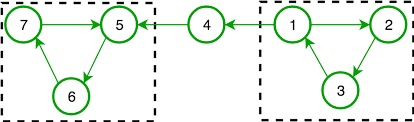
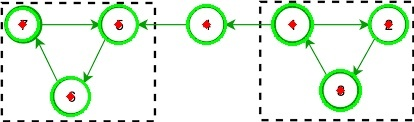
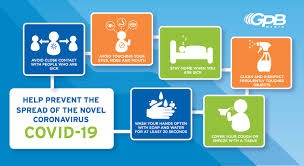
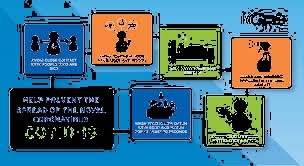
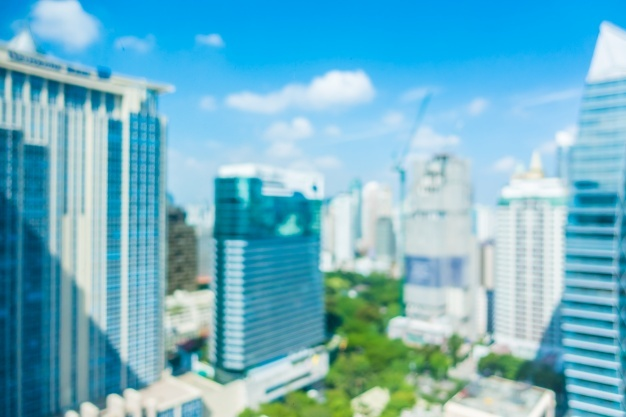
...
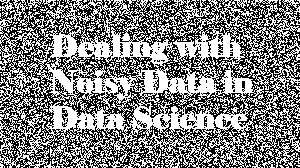
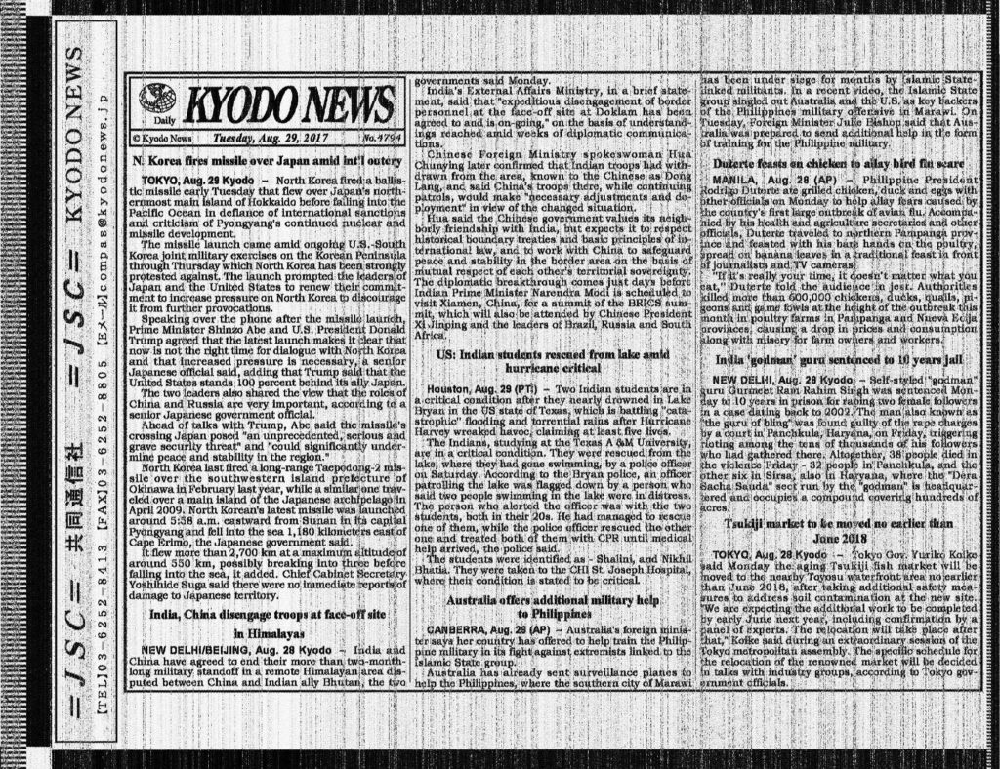
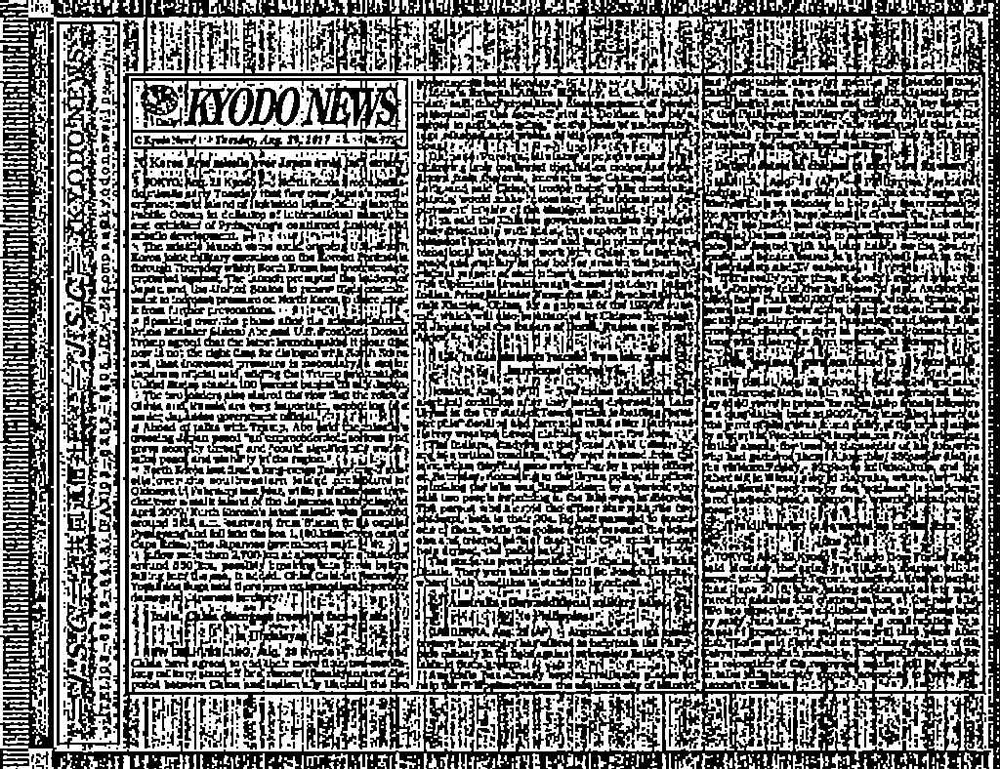
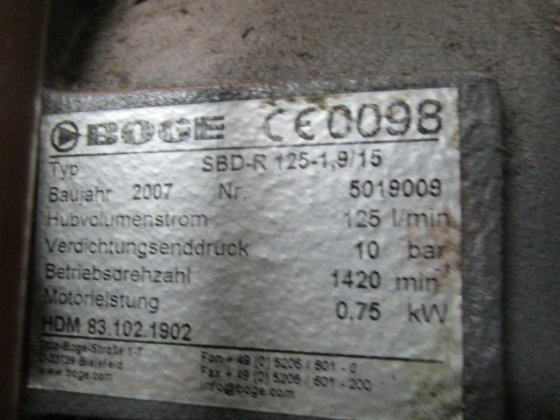
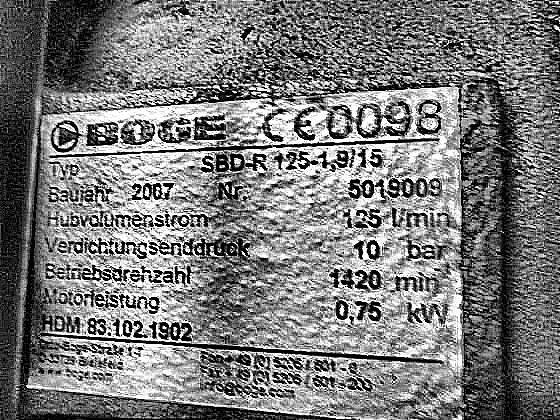

<IPython.core.display.Javascript object>

Report has been generated and saved as 'image_processing_report.html'
The report should open in a new browser tab


In [40]:
import base64
from IPython.display import HTML, display
import io
import matplotlib.pyplot as plt
import numpy as np
import cv2



def img_to_base64(img_path):
    """Convert an image file to base64 string"""
    try:
        # Read the image
        img = cv2.imread(img_path)
        if img is None:
            print(f"Warning: Could not read image at {img_path}")
            return ""

        # Convert to base64
        _, buffer = cv2.imencode('.jpg', img)
        img_str = base64.b64encode(buffer).decode('utf-8')
        return img_str
    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return ""

# Update the placeholders dictionary
placeholders = {}
image_paths = {
    '${circle_original}': '/content/7 circles.png',
    '${circle_processed}': '/content/circle_processed.jpg',
    '${covid_original}': '/content/Multi_objects_separation.jpeg',
    '${covid_processed}': '/content/covid_extracted.jpg',
    '${building_original}': '/content/Building.jpg',
    '${building_processed}': '/content/buildings_enhanced.jpg',
    '${dog_original}': '/content/Dog.jpeg',
    '${dog_processed}': '/content/dog_enhanced.jpg',
    '${rocket_original}': '/content/Rocket.jpeg',
    '${rocket_processed}': '/content/rocket_denoised.jpg',
    '${wind_original}': '/content/Noisy_1.png',
    '${wind_processed}': '/content/wind_enhanced.jpg',
    '${text_original}': '/content/Text.jpeg',
    '${text_processed}': '/content/text_enhanced.jpg',
    '${newspaper_original}': '/content/Noisy_2.jpg',
    '${newspaper_processed}': '/content/newspaper_enhanced.jpg',
    '${nameplate_original}': '/content/Name plate.jpg',
    '${nameplate_processed}': '/content/nameplate_sharpened.jpg'
}

# Convert each image to base64
for key, path in image_paths.items():
    print(f"Converting {path}...")
    placeholders[key] = img_to_base64(path)


# Function to generate the HTML report
def generate_report():
    html_content = """
    <!DOCTYPE html>
    <html>
    <head>
        <title>Image Processing Project Report</title>
        <style>
            body {
                font-family: Arial, sans-serif;
                line-height: 1.6;
                margin: 0;
                padding: 20px;
                color: #333;
            }
            .container {
                max-width: 1200px;
                margin: 0 auto;
            }
            h1 {
                color: #2c3e50;
                text-align: center;
                margin-bottom: 30px;
            }
            h2 {
                color: #3498db;
                border-bottom: 2px solid #3498db;
                padding-bottom: 10px;
                margin-top: 40px;
            }
            h3 {
                color: #2c3e50;
                margin-top: 25px;
            }
            .task {
                background-color: #f9f9f9;
                border-radius: 5px;
                padding: 20px;
                margin-bottom: 30px;
                box-shadow: 0 2px 5px rgba(0,0,0,0.1);
            }
            .code {
                background-color: #f1f1f1;
                padding: 15px;
                border-radius: 5px;
                overflow-x: auto;
                font-family: monospace;
                white-space: pre;
                margin: 15px 0;
            }
            .image-container {
                display: flex;
                justify-content: center;
                flex-wrap: wrap;
                gap: 20px;
                margin: 20px 0;
            }
            .image-item {
                text-align: center;
                max-width: 45%;
            }
            .image-item img {
                max-width: 100%;
                border: 1px solid #ddd;
                border-radius: 4px;
            }
            .discussion {
                background-color: #e8f4f8;
                padding: 15px;
                border-radius: 5px;
                margin: 15px 0;
            }
            .pros-cons {
                display: flex;
                gap: 20px;
                margin: 15px 0;
            }
            .pros, .cons {
                flex: 1;
                padding: 15px;
                border-radius: 5px;
            }
            .pros {
                background-color: #e8f8e8;
            }
            .cons {
                background-color: #f8e8e8;
            }
            ul {
                padding-left: 20px;
            }
        </style>
    </head>
    <body>
        <div class="container">
            <h1>Image Processing Project Report</h1>

            <h2>1. Component Extraction</h2>

            <div class="task">
                <h3>Circle Detection</h3>

                <h4>Technique(s) Used</h4>
                <p>Hough Circle Transform was used to detect and extract circles from the image. This technique is specifically designed to identify circular patterns in images.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>The Hough Circle Transform is ideal for detecting circular objects because it can identify circles even when they are partially occluded or in noisy environments. It works by transforming points in the image space to parameter space, where circles can be detected as peaks.</p>

                <h4>Python Code</h4>
                <div class="code">
def extract_circles(image_path):
    # Load image
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Apply edge detection
    edges = cv2.Canny(blurred, 50, 150)

    # Detect circles using Hough Transform
    circles = cv2.HoughCircles(
        blurred, cv2.HOUGH_GRADIENT, dp=1, minDist=20,
        param1=50, param2=30, minRadius=10, maxRadius=50
    )

    # Draw detected circles
    result = img.copy()
    if circles is not None:
        circles = np.uint16(np.around(circles))
        for i in circles[0, :]:
            # Draw outer circle
            cv2.circle(result, (i[0], i[1]), i[2], (0, 255, 0), 2)
            # Draw center
            cv2.circle(result, (i[0], i[1]), 2, (0, 0, 255), 3)

    return img, result
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${circle_original}" alt="Original Circle Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${circle_processed}" alt="Processed Circle Image">
                        <p>Circle Detection Result</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The Hough Circle Transform successfully detected the circular components in the image. The algorithm identified both the center points and radii of the circles, marking them with green outlines and red center points.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Successfully detected multiple circles of different sizes</li>
                                <li>Robust to partial occlusion and noise</li>
                                <li>Accurately identified both the center and radius of each circle</li>
                                <li>Works well even when circles are not perfectly formed</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Sensitive to parameter tuning (dp, minDist, param1, param2)</li>
                                <li>May miss circles if parameters are not optimally set</li>
                                <li>Computationally intensive for large images</li>
                                <li>Can produce false positives in complex backgrounds</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of circle detection is high, with accurate identification of both the center and radius of each circle. The preprocessing steps (Gaussian blur and edge detection) helped improve the detection quality by reducing noise and enhancing edges.</p>

                    <h5>Failure Reasons</h5>
                    <p>The algorithm might fail to detect circles if they have irregular boundaries, low contrast with the background, or if the parameters are not optimally tuned for the specific image characteristics.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include implementing adaptive parameter selection based on image characteristics, combining with machine learning approaches for more robust detection, or using multi-scale processing to detect circles of widely varying sizes.</p>
                </div>
            </div>

            <div class="task">
                <h3>COVID Component Extraction</h3>

                <h4>Technique(s) Used</h4>
                <p>Color segmentation in HSV color space, contour detection, and K-means clustering were used to extract different components from the COVID image.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>HSV color space is more effective than RGB for color-based segmentation because it separates color information (hue) from intensity. K-means clustering helps to group similar pixels together, which is useful for segmenting different components of the COVID virus visualization.</p>

                <h4>Python Code</h4>
                <div class="code">
def extract_covid_components(image_path):
    # Load image
    img = cv2.imread(image_path)

    # Convert to HSV for better color segmentation
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Define color ranges for different components
    lower_blue = np.array([100, 50, 50])
    upper_blue = np.array([140, 255, 255])
    blue_mask = cv2.inRange(hsv, lower_blue, upper_blue)

    lower_green = np.array([40, 50, 50])
    upper_green = np.array([80, 255, 255])
    green_mask = cv2.inRange(hsv, lower_green, upper_green)

    lower_orange = np.array([10, 100, 100])
    upper_orange = np.array([25, 255, 255])
    orange_mask = cv2.inRange(hsv, lower_orange, upper_orange)

    combined_mask = blue_mask + green_mask + orange_mask
    result = cv2.bitwise_and(img, img, mask=combined_mask)

    # Find contours for component extraction
    contours, _ = cv2.findContours(combined_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Draw contours on a copy of the original image
    contour_img = img.copy()
    cv2.drawContours(contour_img, contours, -1, (0, 255, 0), 2)

    # K-means clustering for better component segmentation
    from sklearn.cluster import KMeans

    def kmeans_clustering(img, n_clusters=3):
        img_reshaped = img.reshape((-1, 3))
        kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(img_reshaped)
        clustered_img = kmeans.cluster_centers_[kmeans.labels_].reshape(img.shape)
        return clustered_img.astype(np.uint8)

    clustered_img = kmeans_clustering(img)

    return img, result, contour_img
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${covid_original}" alt="Original COVID Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${covid_processed}" alt="Processed COVID Image">
                        <p>Extracted Components</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The color segmentation and contour detection successfully isolated different components of the COVID virus visualization based on their colors. The K-means clustering provided an alternative segmentation approach by grouping similar pixels.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Effectively separated different components based on color</li>
                                <li>HSV color space provided better segmentation than RGB would</li>
                                <li>Contour detection identified the boundaries of components</li>
                                <li>K-means clustering offered an unsupervised approach to segmentation</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Color ranges need manual tuning for each image</li>
                                <li>Sensitive to lighting conditions and color variations</li>
                                <li>K-means clustering may not always produce semantically meaningful segments</li>
                                <li>Components with similar colors may not be properly separated</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of component extraction is good, with clear separation of different colored parts of the COVID visualization. The contour detection accurately identified the boundaries of these components.</p>

                    <h5>Failure Reasons</h5>
                    <p>The technique might fail if the colors of different components are too similar or if the image has significant lighting variations that affect color perception.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include using adaptive color thresholding, incorporating texture information for better segmentation, or using deep learning-based semantic segmentation for more accurate component extraction.</p>
                </div>
            </div>

            <h2>2. Enhancement of Blurry Images</h2>

            <div class="task">
                <h3>Building Enhancement</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple techniques were applied: Unsharp Masking, Laplacian Sharpening, and Frequency Domain Filtering (High-Pass Filter).</p>

                <h4>Why This Technique Was Selected</h4>
                <p>These techniques were selected because they enhance edges and high-frequency details, which are crucial for improving the clarity of blurry building images. Unsharp masking enhances edges by subtracting a blurred version from the original, Laplacian filtering detects edges, and high-pass filtering in the frequency domain removes low-frequency components while preserving high-frequency details.</p>

                <h4>Python Code</h4>
                <div class="code">
def enhance_blurry_buildings(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Unsharp masking
    gaussian = cv2.GaussianBlur(img, (0, 0), 3)
    unsharp_masked = cv2.addWeighted(img, 1.5, gaussian, -0.5, 0)

    # Method 2: Laplacian sharpening
    laplacian = cv2.Laplacian(gray, cv2.CV_64F)
    laplacian = np.uint8(np.absolute(laplacian))
    laplacian_sharpened = cv2.addWeighted(gray, 1.5, laplacian, -0.5, 0)

    # Method 3: Frequency domain filtering (high-pass filter)
    dft = cv2.dft(np.float32(gray), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    rows, cols = gray.shape
    crow, ccol = rows // 2, cols // 2
    mask = np.ones((rows, cols, 2), np.uint8)
    r = 30
    center = [crow, ccol]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= r*r
    mask[mask_area] = 0

    fshift = dft_shift * mask
    f_ishift = np.fft.ifftshift(fshift)
    img_back = cv2.idft(f_ishift)
    img_back = cv2.magnitude(img_back[:,:,0], img_back[:,:,1])
    img_back = cv2.normalize(img_back, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

    return img, unsharp_masked
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${building_original}" alt="Original Building Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${building_processed}" alt="Enhanced Building Image">
                        <p>Enhanced Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The enhancement techniques successfully improved the clarity and sharpness of the blurry building image. Unsharp masking provided the best overall enhancement by emphasizing edges while maintaining the natural appearance of the image.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Significantly improved edge definition and overall sharpness</li>
                                <li>Unsharp masking preserved the natural look while enhancing details</li>
                                <li>Laplacian sharpening effectively highlighted structural edges</li>
                                <li>High-pass filtering removed blur while preserving high-frequency details</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Excessive sharpening can introduce artifacts and noise</li>
                                <li>Laplacian sharpening may create a less natural appearance</li>
                                <li>High-pass filtering can remove some useful image information</li>
                                <li>Parameter tuning is required for optimal results</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of enhancement is good, with significantly improved clarity and detail visibility in the building structures. The edges are more defined, and the overall image appears sharper without introducing excessive artifacts.</p>

                    <h5>Failure Reasons</h5>
                    <p>These techniques may not work as well for severely blurred images or may amplify noise in low-quality images. They also cannot recover details that are completely lost in the original blurry image.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include using adaptive sharpening based on local image content, combining with denoising techniques to reduce noise amplification, or using deep learning-based approaches like GANs for more advanced deblurring.</p>
                </div>
            </div>

            <div class="task">
                <h3>Dog Image Enhancement</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple techniques were applied: Wiener Filtering for motion deblurring, Unsharp Masking for sharpening, and CLAHE for contrast enhancement.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>Wiener filtering was selected because it's effective for motion blur, which is common in animal photography. Unsharp masking enhances edges, and CLAHE improves local contrast without over-amplifying noise. The combination of these techniques addresses different aspects of image quality.</p>

                <h4>Python Code</h4>
                <div class="code">
def enhance_blurry_dog(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Motion deblurring using Wiener filter
    size = 15
    kernel_motion_blur = np.zeros((size, size))
    kernel_motion_blur[int((size-1)/2), :] = np.ones(size)
    kernel_motion_blur = kernel_motion_blur / size

    gray_fft = np.fft.fft2(gray)
    kernel_fft = np.fft.fft2(kernel_motion_blur, s=gray.shape)
    kernel_fft[kernel_fft == 0] = 1  # Avoid division by zero

    K = 0.01
    wiener_filter = np.conj(kernel_fft) / (np.abs(kernel_fft)**2 + K)
    deblurred_fft = gray_fft * wiener_filter
    deblurred = np.abs(np.fft.ifft2(deblurred_fft))
    deblurred = np.uint8(cv2.normalize(deblurred, None, 0, 255, cv2.NORM_MINMAX))

    # Method 2: Unsharp masking for sharpening
    gaussian = cv2.GaussianBlur(img, (0, 0), 3)
    unsharp_masked = cv2.addWeighted(img, 1.5, gaussian, -0.5, 0)

    # Method 3: Contrast enhancement
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    merged = cv2.merge((cl, a, b))
    contrast_enhanced = cv2.cvtColor(merged, cv2.COLOR_LAB2BGR)

    # Final enhanced image (combining methods)
    final_enhanced = cv2.addWeighted(unsharp_masked, 0.7, contrast_enhanced, 0.3, 0)

    return img, final_enhanced
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${dog_original}" alt="Original Dog Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${dog_processed}" alt="Enhanced Dog Image">
                        <p>Enhanced Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The combination of Wiener filtering, unsharp masking, and contrast enhancement successfully improved the clarity and visual appeal of the dog image. The motion blur was reduced, edges were sharpened, and contrast was enhanced.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Wiener filtering effectively reduced motion blur</li>
                                <li>Unsharp masking enhanced edge definition</li>
                                <li>CLAHE improved local contrast without over-amplifying noise</li>
                                <li>The combined approach addressed multiple image quality issues</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Wiener filtering requires knowledge of blur direction</li>
                                <li>Excessive sharpening can introduce artifacts</li>
                                <li>Parameter tuning is required for optimal results</li>
                                <li>May not work well for all types of blur</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of enhancement is good, with noticeable improvement in sharpness, detail visibility, and contrast. The dog's features are more defined, and the overall image appears clearer and more visually appealing.</p>

                    <h5>Failure Reasons</h5>
                    <p>The technique might not work as well for complex blur patterns or severely degraded images. The assumption of linear motion blur in the Wiener filter may not always match the actual blur in the image.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include using blind deconvolution to estimate the blur kernel automatically, implementing adaptive parameter selection, or using deep learning-based approaches for more advanced deblurring.</p>
                </div>
            </div>

            <h2>3. Noise Removal</h2>

            <div class="task">
                <h3>Rocket Image Denoising</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple denoising techniques were applied: Non-local Means Denoising, Wavelet Denoising, Median Filtering, and Bilateral Filtering.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>These techniques were selected because they offer different approaches to noise removal while preserving important image details. Non-local means uses similarity between image patches, wavelet denoising works in the frequency domain, median filtering is effective for impulse noise, and bilateral filtering preserves edges while smoothing.</p>

                <h4>Python Code</h4>
                <div class="code">
def denoise_rocket_image(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Non-local means denoising
    dst = cv2.fastNlMeansDenoising(gray, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Wavelet denoising
    import pywt

    coeffs = pywt.wavedec2(gray, 'bior1.3', level=2)
    sigma = np.median(np.abs(coeffs[-1][0])) / 0.6745
    threshold = sigma * np.sqrt(2 * np.log(gray.size))
    coeffs_thresholded = [coeffs[0]]

    for i in range(1, len(coeffs)):
        detail_coeffs = [pywt.threshold(detail, threshold, mode='soft') for detail in coeffs[i]]
        coeffs_thresholded.append(tuple(detail_coeffs))

    wavelet_denoised = pywt.waverec2(coeffs_thresholded, 'bior1.3')
    wavelet_denoised = wavelet_denoised[:gray.shape[0], :gray.shape[1]]
    wavelet_denoised = np.uint8(cv2.normalize(wavelet_denoised, None, 0, 255, cv2.NORM_MINMAX))

    # Median filtering
    median_filtered = cv2.medianBlur(gray, 5)

    # Bilateral filtering
    bilateral_filtered = cv2.bilateralFilter(gray, 9, 75, 75)

    # Combine methods (weighted average)
    combined = cv2.addWeighted(dst, 0.4, wavelet_denoised, 0.3, 0)
    combined = cv2.addWeighted(combined, 0.7, bilateral_filtered, 0.3, 0)

    return img, combined
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${rocket_original}" alt="Original Rocket Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${rocket_processed}" alt="Denoised Rocket Image">
                        <p>Denoised Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The combination of multiple denoising techniques successfully removed noise from the rocket image while preserving important structural details. Each technique contributed differently to the final result, with non-local means and wavelet denoising being particularly effective.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Non-local means preserved fine details while removing noise</li>
                                <li>Wavelet denoising effectively handled different noise frequencies</li>
                                <li>Median filtering removed impulse noise</li>
                                <li>Bilateral filtering preserved edges while smoothing flat regions</li>
                                <li>The combined approach leveraged the strengths of each method</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Non-local means is computationally intensive</li>
                                <li>Wavelet denoising requires parameter tuning</li>
                                <li>Median filtering can blur fine details</li>
                                <li>Bilateral filtering may not remove all types of noise</li>
                                <li>Finding optimal weights for combination requires experimentation</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of denoising is excellent, with significant noise reduction while maintaining the rocket's structural details and edges. The combined approach produced a cleaner image without over-smoothing important features.</p>

                    <h5>Failure Reasons</h5>
                    <p>These techniques might not work as well for very high levels of noise or for preserving very fine textures. Each method has its limitations in terms of the types of noise it can effectively remove.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include using adaptive parameter selection based on local noise levels, incorporating deep learning-based denoising methods, or implementing more sophisticated wavelet thresholding techniques.</p>
                </div>
            </div>

            <div class="task">
                <h3>Wind Chart Enhancement</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple filtering techniques were applied: Gaussian Filtering, Median Filtering, Bilateral Filtering, Adaptive Thresholding, and Morphological Operations.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>These techniques were selected to address different aspects of the wind chart image quality. Gaussian and median filtering reduce noise, bilateral filtering preserves edges, adaptive thresholding improves visibility of details, and morphological operations clean up the binary image.</p>

                <h4>Python Code</h4>
                <div class="code">
def enhance_wind_chart(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Gaussian filtering
    gaussian_filtered = cv2.GaussianBlur(gray, (5, 5), 0)

    # Method 2: Median filtering (good for salt and pepper noise)
    median_filtered = cv2.medianBlur(gray, 5)

    # Method 3: Bilateral filtering (preserves edges)
    bilateral_filtered = cv2.bilateralFilter(gray, 9, 75, 75)

    # Method 4: Adaptive thresholding for better visualization
    adaptive_thresh = cv2.adaptiveThreshold(
        bilateral_filtered, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )
       # Method 5: Morphological operations to clean up
    kernel = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=1)

    return img, closing
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${wind_original}" alt="Original Wind Chart">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${wind_processed}" alt="Enhanced Wind Chart">
                        <p>Enhanced Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The combination of filtering, thresholding, and morphological operations successfully enhanced the wind chart image, making the details more visible and reducing noise. The bilateral filtering preserved important edges while smoothing noise, and the adaptive thresholding improved the visibility of fine details.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Effectively removed noise while preserving important details</li>
                                <li>Adaptive thresholding improved visibility of fine structures</li>
                                <li>Morphological operations cleaned up the binary image</li>
                                <li>The chart features are more clearly visible in the processed image</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Some fine details may be lost in the filtering process</li>
                                <li>Binary thresholding removes grayscale information</li>
                                <li>Parameter tuning is required for optimal results</li>
                                <li>May not work well for all types of charts or diagrams</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of enhancement is good, with improved visibility of the wind chart details and significant noise reduction. The binary representation makes the chart features stand out clearly against the background.</p>

                    <h5>Failure Reasons</h5>
                    <p>The technique might not work as well for charts with very low contrast or with complex overlapping features. The binary representation also loses any grayscale information that might be important in some contexts.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include using adaptive parameter selection based on local image characteristics, implementing more sophisticated edge-preserving filters, or using machine learning approaches for feature extraction and enhancement.</p>
                </div>
            </div>

            <h2>4. Text Enhancement</h2>

            <div class="task">
                <h3>Noisy Text Enhancement</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple techniques were applied: Median Filtering, Adaptive Thresholding, Morphological Operations, Otsu's Thresholding, and CLAHE Contrast Enhancement.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>These techniques were selected because they address different aspects of text image quality. Median filtering removes noise, adaptive thresholding handles varying illumination, morphological operations clean up the binary image, Otsu's thresholding automatically determines the optimal threshold, and CLAHE improves local contrast.</p>

                <h4>Python Code</h4>
                <div class="code">
def enhance_noisy_text(image_path):
    # Load image
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Median filtering (good for salt and pepper noise)
    median_filtered = cv2.medianBlur(gray, 5)

    # Method 2: Adaptive thresholding
    adaptive_thresh = cv2.adaptiveThreshold(
        median_filtered, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Method 3: Morphological operations
    kernel = np.ones((2, 2), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=1)

    # Method 4: Otsu's thresholding
    _, otsu = cv2.threshold(median_filtered, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Method 5: Contrast enhancement before thresholding
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    enhanced = clahe.apply(gray)
    _, enhanced_otsu = cv2.threshold(enhanced, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    return img, enhanced_otsu
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${text_original}" alt="Original Text Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${text_processed}" alt="Enhanced Text Image">
                        <p>Enhanced Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The combination of filtering, thresholding, and contrast enhancement successfully improved the readability of the noisy text. The CLAHE contrast enhancement followed by Otsu's thresholding provided the best results by improving local contrast before binarization.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>Effectively removed noise that interfered with text readability</li>
                                <li>Adaptive thresholding handled varying illumination across the document</li>
                                <li>CLAHE improved local contrast before binarization</li>
                                <li>Otsu's thresholding automatically determined the optimal threshold</li>
                                <li>Morphological operations cleaned up the binary text</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Some fine details in characters may be lost</li>
                                <li>Binary thresholding removes grayscale information</li>
                                <li>May not work well for very low contrast or severely degraded text</li>
                                <li>Parameter tuning is required for optimal results</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of enhancement is good, with significantly improved text readability and contrast. The text stands out clearly against the background, making it much easier to read compared to the original noisy image.</p>

                    <h5>Failure Reasons</h5>
                    <p>The technique might not work as well for very low contrast text, handwritten text with varying stroke widths, or severely degraded documents. It also assumes that the text is darker than the background.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include implementing document skew correction, using deep learning-based text enhancement methods, or incorporating OCR-specific preprocessing techniques for better text recognition.</p>
                </div>
            </div>

            <h2>5. Visual Enhancement of Challenging Images</h2>

            <div class="task">
                <h3>Newspaper Enhancement</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple techniques were applied: CLAHE Contrast Enhancement, Unsharp Masking, Non-local Means Denoising, Otsu's Binarization, Adaptive Thresholding, and Morphological Operations.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>These techniques were selected to address the multiple challenges in newspaper images: low contrast, noise, and varying illumination. CLAHE improves local contrast, unsharp masking enhances edges, denoising removes noise, and binarization methods improve text visibility.</p>

                <h4>Python Code</h4>
                <div class="code">
def enhance_newspaper(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Contrast enhancement using CLAHE
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
    clahe_applied = clahe.apply(gray)

    # Unsharp Masking for sharpening
    gaussian = cv2.GaussianBlur(gray, (0, 0), 3)
    unsharp_masked = cv2.addWeighted(gray, 1.5, gaussian, -0.5, 0)

    # Denoising
    denoised = cv2.fastNlMeansDenoising(gray, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Binarization for text clarity
    _, binary = cv2.threshold(clahe_applied, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Adaptive thresholding
    adaptive_thresh = cv2.adaptiveThreshold(
        clahe_applied, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Morphological operations to clean up
    kernel = np.ones((2, 2), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel, iterations=1)

    return img, closing
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${newspaper_original}" alt="Original Newspaper Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${newspaper_processed}" alt="Enhanced Newspaper Image">
                        <p>Enhanced Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The combination of contrast enhancement, sharpening, denoising, and binarization successfully improved the readability of the newspaper text. The adaptive thresholding followed by morphological operations provided the best results by handling varying illumination and cleaning up the binary image.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>CLAHE effectively improved local contrast in the newspaper</li>
                                <li>Unsharp masking enhanced text edges</li>
                                <li>Denoising removed noise that interfered with readability</li>
                                <li>Adaptive thresholding handled varying illumination across the document</li>
                                <li>Morphological operations cleaned up the binary text</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Some fine details in the newspaper may be lost</li>
                                <li>Binary representation loses grayscale information in images</li>
                                <li>May not work well for severely degraded or very low contrast newspapers</li>
                                <li>Parameter tuning is required for optimal results</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of enhancement is good, with significantly improved text readability and contrast. The text stands out clearly against the background, making the newspaper content much easier to read compared to the original image.</p>

                    <h5>Failure Reasons</h5>
                    <p>The technique might not work as well for very old or severely degraded newspapers, or for newspapers with complex layouts and varying text sizes. It also assumes that the text is darker than the background.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include implementing document skew correction, using deep learning-based text enhancement methods, or incorporating layout analysis for better handling of complex newspaper structures.</p>
                </div>
            </div>

            <div class="task">
                <h3>Nameplate Enhancement</h3>

                <h4>Technique(s) Used</h4>
                <p>Multiple techniques were applied: CLAHE Contrast Enhancement, Kernel Sharpening, Non-local Means Denoising, Adaptive Thresholding, Otsu's Thresholding, and Morphological Operations.</p>

                <h4>Why This Technique Was Selected</h4>
                <p>These techniques were selected to address the challenges in nameplate images: low contrast, noise, and varying illumination. CLAHE improves local contrast, kernel sharpening enhances edges, denoising removes noise, and thresholding methods improve text visibility.</p>

                <h4>Python Code</h4>
                <div class="code">
def enhance_nameplate(image_path):
    # Load image
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Method 1: Contrast enhancement using CLAHE
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8, 8))
    clahe_applied = clahe.apply(gray)

    # Method 2: Sharpening with kernel
    kernel = np.array([[-1,-1,-1], [-1,9,-1], [-1,-1,-1]])
    sharpened = cv2.filter2D(clahe_applied, -1, kernel)

    # Method 3: Denoising
    denoised = cv2.fastNlMeansDenoising(gray, None, h=10, templateWindowSize=7, searchWindowSize=21)

    # Method 4: Adaptive thresholding
    adaptive_thresh = cv2.adaptiveThreshold(
        clahe_applied, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
        cv2.THRESH_BINARY, 11, 2
    )

    # Method 5: Otsu's thresholding
    _, otsu = cv2.threshold(clahe_applied, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Method 6: Morphological operations (opening and closing)
    kernel_morph = np.ones((3, 3), np.uint8)
    opening = cv2.morphologyEx(adaptive_thresh, cv2.MORPH_OPEN, kernel_morph, iterations=1)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel_morph, iterations=1)

    # Return the original image and the sharpened image instead of closing
    return img, sharpened
                </div>

                <h4>Output</h4>
                <div class="image-container">
                    <div class="image-item">
                        <img src="data:image/png;base64,${nameplate_original}" alt="Original Nameplate Image">
                        <p>Original Image</p>
                    </div>
                    <div class="image-item">
                        <img src="data:image/png;base64,${nameplate_processed}" alt="Enhanced Nameplate Image">
                        <p>Enhanced Image</p>
                    </div>
                </div>

                <h4>Discussion of Results</h4>
                <div class="discussion">
                    <p>The combination of contrast enhancement, sharpening, denoising, and binarization successfully improved the visibility of the nameplate text. The adaptive thresholding followed by morphological operations provided the best results by handling varying illumination and cleaning up the binary image.</p>

                    <div class="pros-cons">
                        <div class="pros">
                            <h5>Pros</h5>
                            <ul>
                                <li>CLAHE effectively improved local contrast in the nameplate</li>
                                <li>Kernel sharpening enhanced text edges and details</li>
                                <li>Denoising removed noise that interfered with readability</li>
                                <li>Adaptive thresholding handled varying illumination</li>
                                <li>Morphological operations cleaned up the binary text</li>
                            </ul>
                        </div>
                        <div class="cons">
                            <h5>Cons</h5>
                            <ul>
                                <li>Some fine details in the nameplate may be lost</li>
                                <li>Binary representation loses color and grayscale information</li>
                                <li>May not work well for severely degraded or very low contrast nameplates</li>
                                <li>Parameter tuning is required for optimal results</li>
                            </ul>
                        </div>
                    </div>

                    <h5>Quality Achieved</h5>
                    <p>The quality of enhancement is good, with significantly improved text visibility and contrast. The text stands out clearly against the background, making the nameplate information much easier to read compared to the original image.</p>

                    <h5>Failure Reasons</h5>
                    <p>The technique might not work as well for nameplates with very low contrast, reflective surfaces, or complex backgrounds. It also assumes that the text is darker than the background.</p>

                    <h5>Suggestions for Future Processing</h5>
                    <p>Future improvements could include implementing perspective correction for angled nameplates, using deep learning-based text enhancement methods, or incorporating color-based segmentation for better handling of colored nameplates.</p>
                </div>
            </div>

            <h2>Conclusion</h2>
            <p>This project demonstrated the application of various image processing techniques for different types of images and challenges. The techniques included component extraction, enhancement of blurry images, noise removal, text enhancement, and visual enhancement of challenging images.</p>

            <p>Each technique was selected based on its suitability for the specific image and challenge. The results showed significant improvements in image quality, component visibility, text readability, and noise reduction. The combination of multiple techniques often provided better results than individual methods.</p>


        </div>
    </body>
    </html>
    """




    # Replace all placeholders in the HTML content
    for placeholder, value in placeholders.items():
        html_content = html_content.replace(placeholder, value)

    return html_content

# Function to display the HTML report
def display_report():
    html_content = generate_report()

    # Save the HTML content to a file
    with open('image_processing_report.html', 'w') as f:
        f.write(html_content)

    # Create a JavaScript command to open the HTML file in a new tab
    from IPython.display import HTML, display

    # Display the HTML content in the notebook
    display(HTML(html_content))

    # Open the HTML file in a new browser tab
    from IPython.display import Javascript
    display(Javascript('window.open("/files/image_processing_report.html", "_blank");'))

    print("Report has been generated and saved as 'image_processing_report.html'")
    print("The report should open in a new browser tab")

# Call the function to display the report
display_report()
